# Predicting Rainfall through machine learning from australian Wether data

https://www.kaggle.com/chandrimad31/rainfall-prediction-using-7-popular-models/notebook

In [1]:
import pandas as pd

##  We shall do the project according to the  CrispDm project methodolgy
###  1) Buisness understanding
###  2) Data Understanding
###  3) Data Preparation
###  4) Modelling
###  5) Evaluation
###  6) Deployment

### CRISP-1 Buisness understanding:
we need to predict whether its going to rain tomorrow based on todays wether conditions

### CRISP-2 Data Understanding
we need to do exploratory data analysis to gain an understanding of the data

In [66]:
!pip install imblearn
!pip install pandas-profiling
!pip install scikit-plot
from pandas_profiling import ProfileReport

In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline

### Loading the dataset into a pandas dataframe 

In [3]:
df = pd.read_csv("weatherAUS.csv")

## Data understanding and Data preparation
## Descreptive Statistics

In [4]:
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=False)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### The dataset has a total of 23 features and 145460 rows
#### There are (145460, 23) rows and columns in the dataset

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [8]:
import warnings
warnings.filterwarnings("ignore")

### Date should be changed to 'date-time' data type in python

In [9]:
temp_df = df.copy()
df['Date'] = df['Date'].astype('datetime64[ns]')

### Mapping the rain today to 1 and 0

In [10]:
df['RainToday'] = df['RainToday'].map({"Yes": 1 , "No":0})
df['RainTomorrow'] = df['RainTomorrow'].map({"Yes": 1 , "No":0})

### distinct values per column

In [58]:
df.head(100)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
5,2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,No
6,2008-12-07,Albury,14.3,25.0,0.0,NaN,NaN,W,50.0,SW,W,20.0,24.0,49.0,19.0,1009.6,1008.2,1.0,NaN,18.1,24.6,No,No
7,2008-12-08,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,6.0,17.0,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,No
8,2008-12-09,Albury,9.7,31.9,0.0,NaN,NaN,NNW,80.0,SE,NW,7.0,28.0,42.0,9.0,1008.9,1003.6,NaN,NaN,18.3,30.2,No,Yes
9,2008-12-10,Albury,13.1,30.1,1.4,NaN,NaN,W,28.0,S,SSE,15.0,11.0,58.0,27.0,1007.0,1005.7,NaN,NaN,20.1,28.2,Yes,No


In [61]:
columns = df.columns
for column in columns:
    print(column,'\t', df[column].unique().shape[0])

Date 	 3436
Location 	 49
MinTemp 	 390
MaxTemp 	 506
Rainfall 	 682
Evaporation 	 359
Sunshine 	 146
WindGustDir 	 17
WindGustSpeed 	 68
WindDir9am 	 17
WindDir3pm 	 17
WindSpeed9am 	 44
WindSpeed3pm 	 45
Humidity9am 	 102
Humidity3pm 	 102
Pressure9am 	 547
Pressure3pm 	 550
Cloud9am 	 11
Cloud3pm 	 11
Temp9am 	 442
Temp3pm 	 503
RainToday 	 3
RainTomorrow 	 3


In [12]:
for column in df.columns:
    if(df[column].unique().shape[0] < 100):
            print('\n\n','Listing values in', column,'Column')
            print(df[column].value_counts())



 Listing values in Location Column
Canberra            3436
Sydney              3344
Brisbane            3193
Darwin              3193
Hobart              3193
Adelaide            3193
Melbourne           3193
Perth               3193
Cairns              3040
Ballarat            3040
MountGambier        3040
Albury              3040
Launceston          3040
Townsville          3040
Wollongong          3040
GoldCoast           3040
MountGinini         3040
Bendigo             3040
AliceSprings        3040
Albany              3040
Newcastle           3039
Penrith             3039
Tuggeranong         3039
Cobar               3009
BadgerysCreek       3009
Richmond            3009
Woomera             3009
MelbourneAirport    3009
Dartmoor            3009
Watsonia            3009
PearceRAAF          3009
PerthAirport        3009
Witchcliffe         3009
Portland            3009
Sale                3009
Nuriootpa           3009
Mildura             3009
Moree               3009
CoffsHarbour 

### Percentage of null values by column 

In [66]:
df.isna().sum().rename('missing').to_frame(name=None)

,missing
Date,0
Location,0
MinTemp,1485
MaxTemp,1261
Rainfall,3261
Evaporation,62790
Sunshine,69835
WindGustDir,10326
WindGustSpeed,10263
WindDir9am,10566


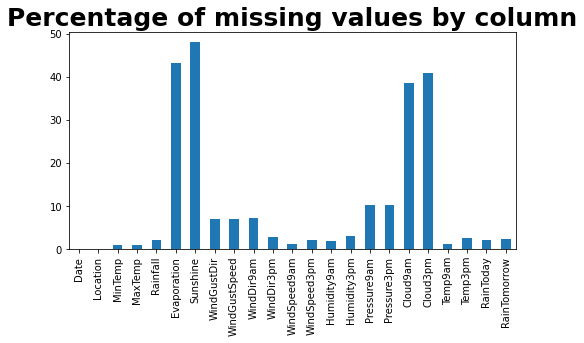

In [13]:
plt.figure(figsize=(8,4)) 
plt.title('Percentage of missing values by column', fontsize=25, weight = 'bold')  
x = df.isna().sum().rename('missing').to_frame(name=None)
x = ((x['missing'])*100)/(df.shape[0])
x.plot(kind = 'bar')
plt.show()

#### The columns evaporation, sunshine,cloud9am,cloud3pm hve more than 40% of the values missing 

## Univariate distributions of numerical variables

In [67]:
df.select_dtypes(include = ["int64","float64"]).columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

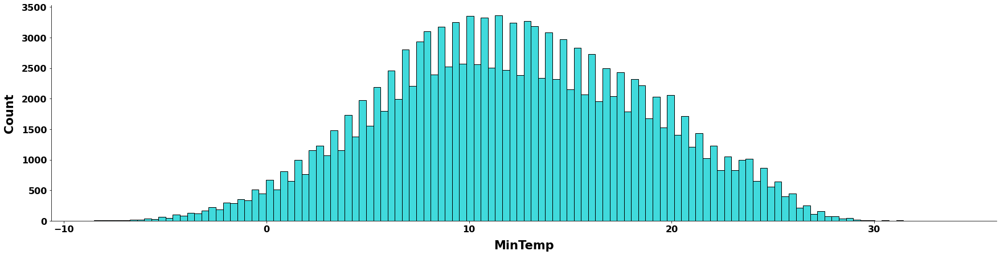

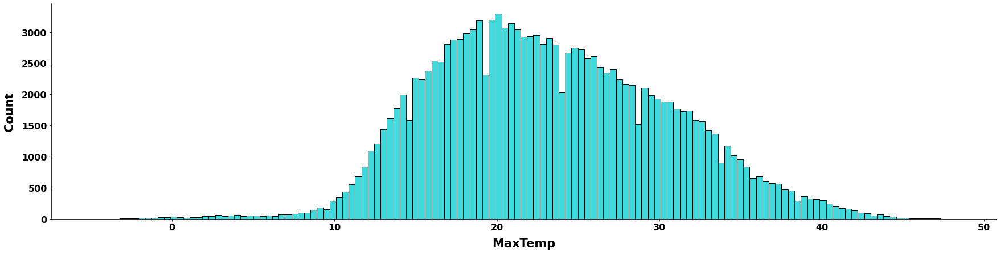

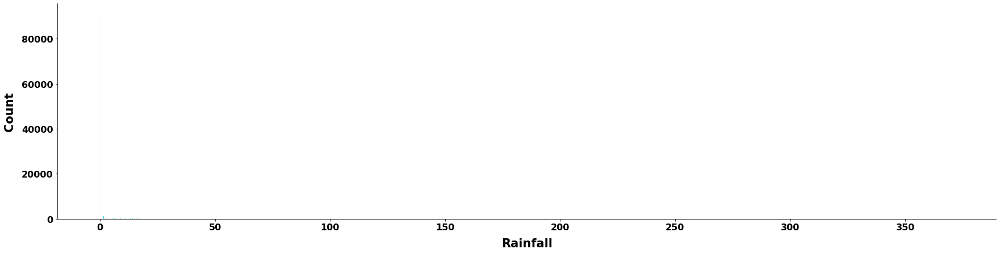

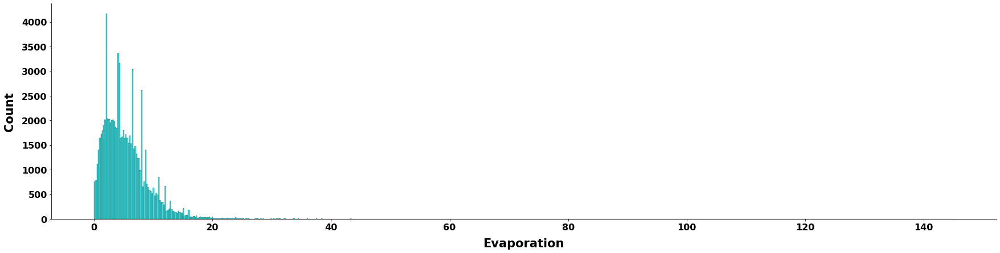

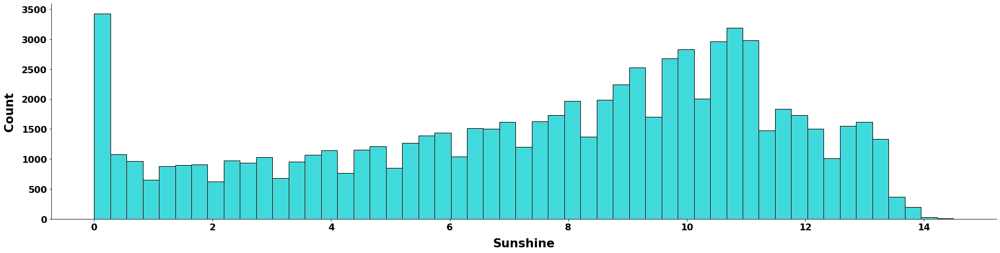

...

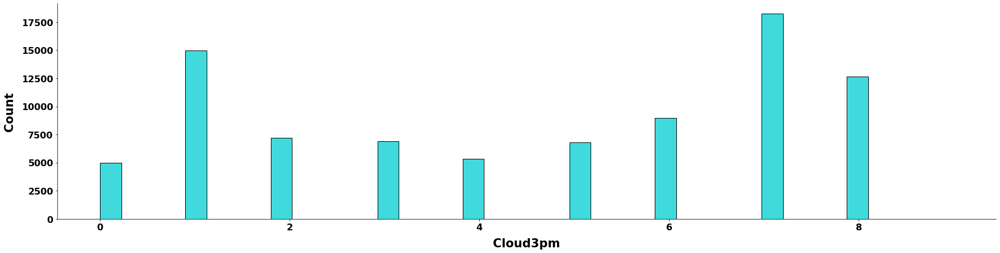

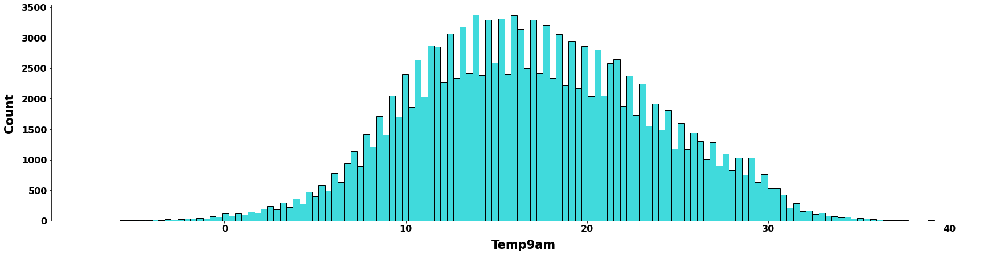

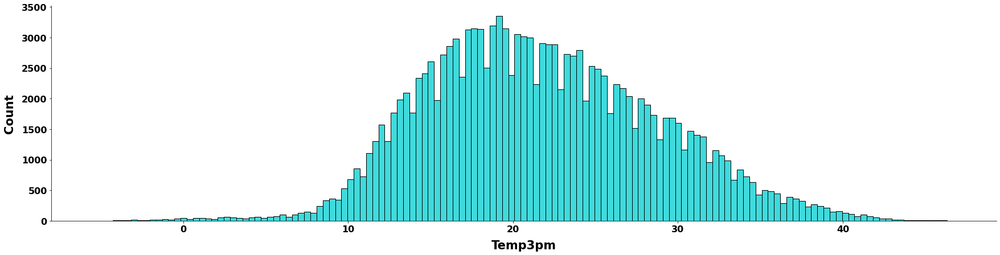

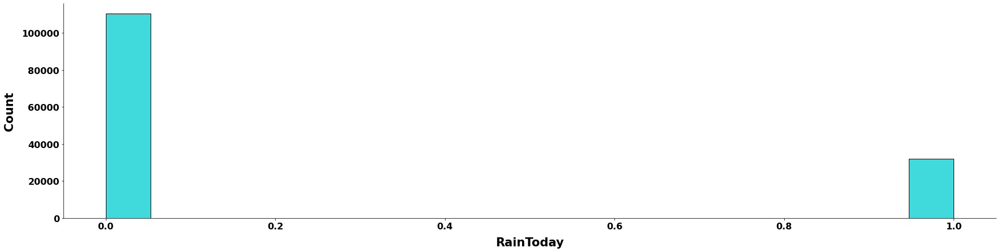

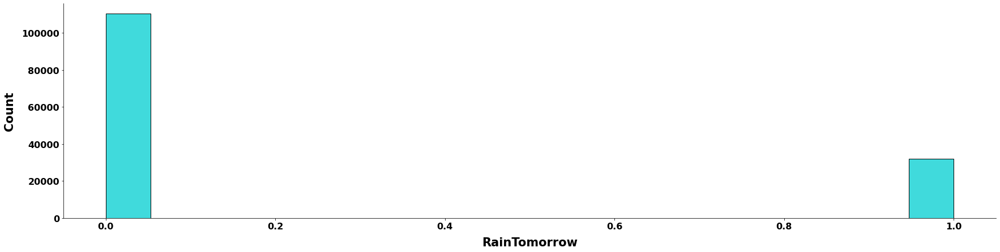

In [12]:
for i in df.select_dtypes(include = ["int64","float64"]).columns : 
    sns.displot(df, x=i, color='darkturquoise',height = 6,aspect = 4, palette="light:#5A9")
    plt.xlabel(i, labelpad=11, fontsize=21, weight = 'bold')
    plt.ylabel("Count", labelpad=11, fontsize=21, weight = 'bold')
    plt.xticks(fontsize=16,weight = 'bold')
    plt.yticks(fontsize=16, weight = 'bold')

In [ ]:
title???

### The target variable is "RainTomorrow", here we will do descriptive statistics of data by including it

<AxesSubplot:xlabel='MaxTemp', ylabel='Probability'>

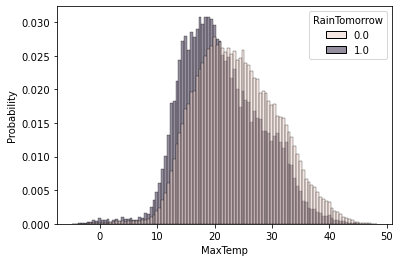

In [13]:
# sns.set_theme(style="darkgrid", palette="rocket")
sns.histplot(df, x='MaxTemp', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.5) 

<AxesSubplot:xlabel='Evaporation', ylabel='Probability'>

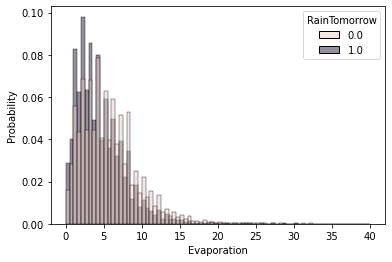

In [14]:
sns.histplot(df, x='Evaporation', hue="RainTomorrow", binrange =[0,40],stat = 'probability', common_norm = False, binwidth=0.5)   

<AxesSubplot:xlabel='Sunshine', ylabel='Probability'>

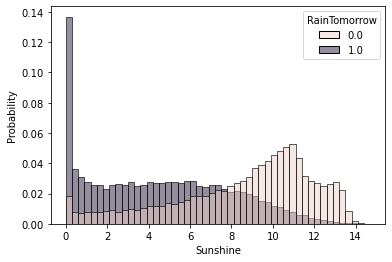

In [15]:
sns.histplot(df, x='Sunshine', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.3)

<AxesSubplot:xlabel='WindGustSpeed', ylabel='Probability'>

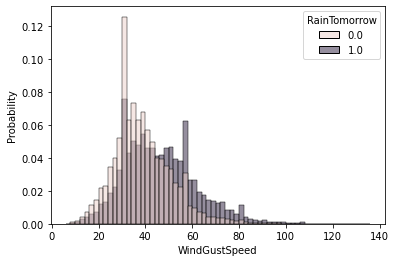

In [16]:
sns.histplot(df, x='WindGustSpeed', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=2)

<AxesSubplot:xlabel='WindSpeed9am', ylabel='Probability'>

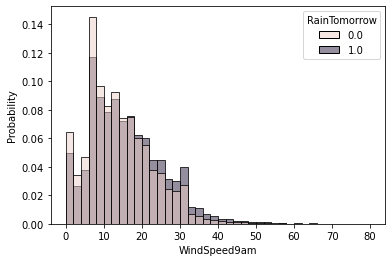

In [17]:
sns.histplot(df, x='WindSpeed9am', hue="RainTomorrow", binrange = [0,80],stat = 'probability', common_norm = False, binwidth=2)

<AxesSubplot:xlabel='WindSpeed3pm', ylabel='Probability'>

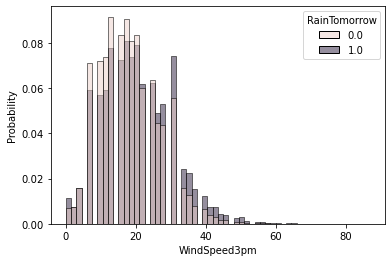

In [18]:
sns.histplot(df, x='WindSpeed3pm', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=1.5)

<AxesSubplot:xlabel='Humidity9am', ylabel='Probability'>

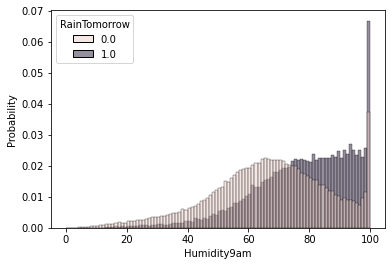

In [19]:
sns.histplot(df, x='Humidity9am', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=1)

<AxesSubplot:xlabel='Humidity3pm', ylabel='Probability'>

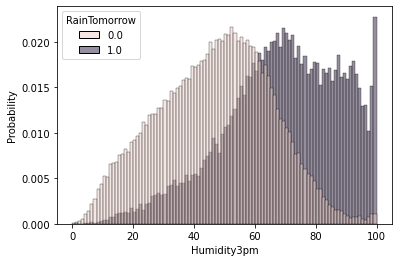

In [20]:
sns.histplot(df, x='Humidity3pm', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=1)

<AxesSubplot:xlabel='Pressure9am', ylabel='Probability'>

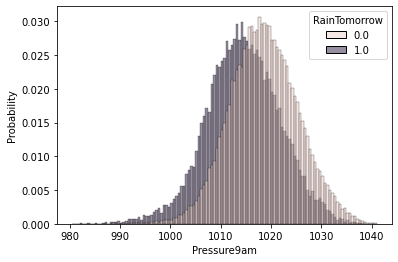

In [21]:
sns.histplot(df, x='Pressure9am', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.5)

<AxesSubplot:xlabel='Pressure3pm', ylabel='Probability'>

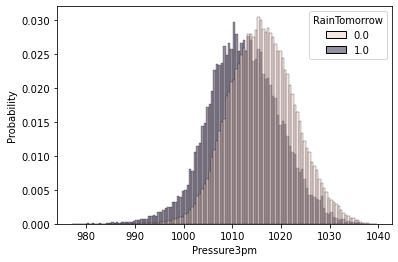

In [22]:
sns.histplot(df, x='Pressure3pm', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.5)

<AxesSubplot:xlabel='Cloud9am', ylabel='Count'>

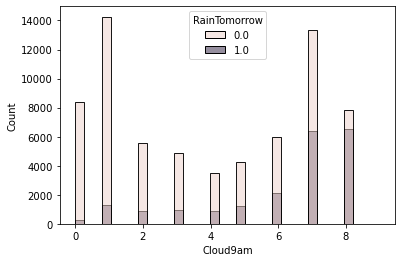

In [23]:
sns.histplot(df, x='Cloud9am', hue="RainTomorrow")

<AxesSubplot:xlabel='Cloud3pm', ylabel='Count'>

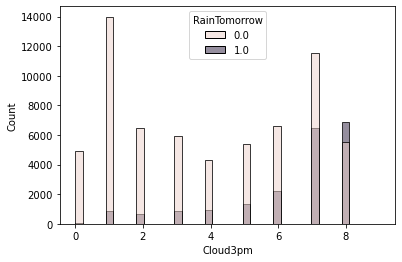

In [24]:
sns.histplot(df, x='Cloud3pm', hue="RainTomorrow")

<AxesSubplot:xlabel='Temp9am', ylabel='Probability'>

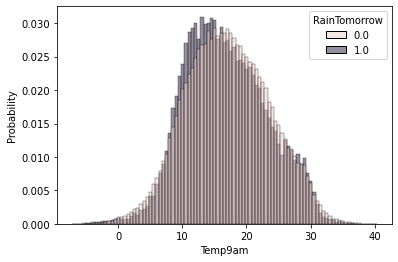

In [25]:
sns.histplot(df, x='Temp9am', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.5)

<AxesSubplot:xlabel='Temp3pm', ylabel='Probability'>

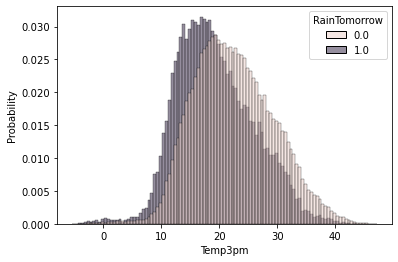

In [26]:
sns.histplot(df, x='Temp3pm', hue="RainTomorrow",stat = 'probability', common_norm = False, binwidth=0.5)

<AxesSubplot:xlabel='RainToday', ylabel='Count'>

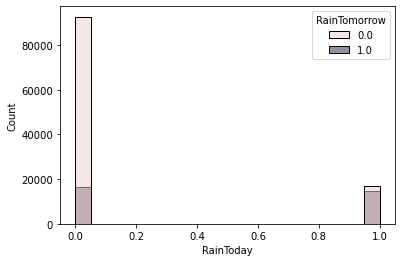

In [27]:
sns.histplot(df, x='RainToday', hue="RainTomorrow")

## Univariate distribution of categorical data

In [32]:
sns.set_theme(style="darkgrid", palette="rocket")

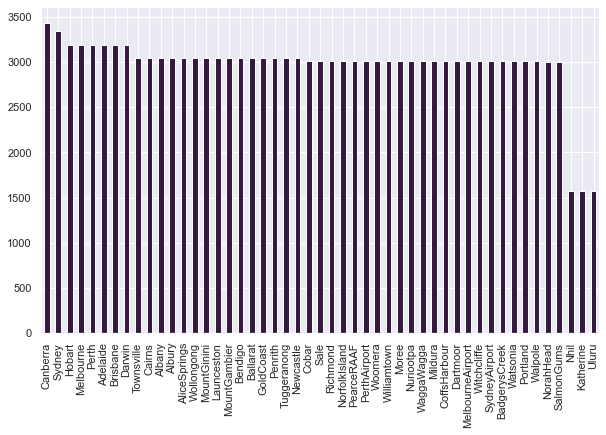

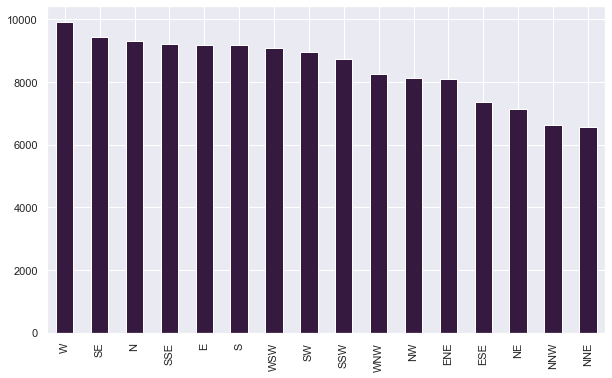

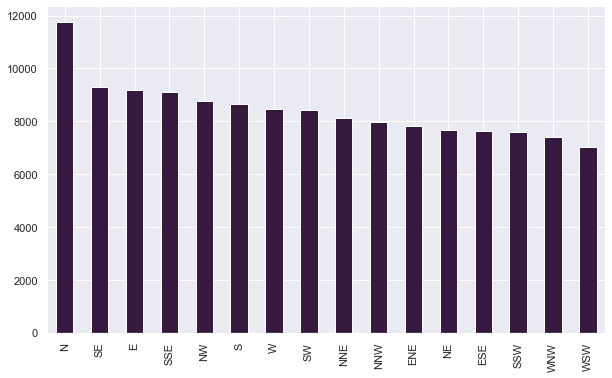

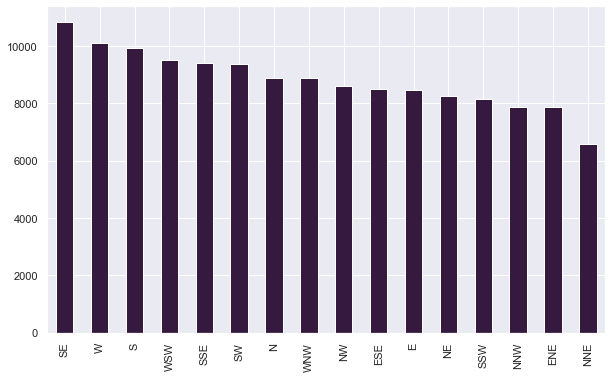

In [29]:
for column in df.select_dtypes(exclude = ["int64","float64","datetime64[ns]"]).columns :
    plt.figure(figsize=(10,6)) 
    df[column].value_counts().plot(kind = 'bar')

### Feature selection
##### The date column is may be ignored because it contains information about the season which is a predictor for rains. As there could be rain or not even in rainy season a model that predicts rain irrespective of the season based on the climatic measures is more usefull. The date column will be ignored for this model so that it doesnt learn to predict rain based on the season bun predicts relying only on measures like wind, temp, pressure etc.

## corelation of independent variables with the target variable

In [14]:
corr = df.corr()[['RainTomorrow']].sort_values(by = 'RainTomorrow')
corr

,RainTomorrow
Sunshine,-0.450768
Pressure9am,-0.246371
Pressure3pm,-0.226031
Temp3pm,-0.192424
MaxTemp,-0.159237
Evaporation,-0.119285
Temp9am,-0.025691
MinTemp,0.083936
WindSpeed3pm,0.087817
WindSpeed9am,0.090995


### ignoring Numerical columns that have very low correlation with the target variable

In [15]:
columns = corr[(corr['RainTomorrow'] > 0.1) | (corr['RainTomorrow'] < -0.1)].reset_index()['index'].tolist()
cat = df.select_dtypes(include = 'object').columns.tolist()
df = df[columns + cat]

### correlation among independent variables

In [17]:
df.drop(axis=1, columns =['RainTomorrow']).corr().unstack().abs().sort_values(ascending = False)

Sunshine       Sunshine         1.000000
Pressure9am    Pressure9am      1.000000
Cloud3pm       Cloud3pm         1.000000
Cloud9am       Cloud9am         1.000000
RainToday      RainToday        1.000000
Humidity9am    Humidity9am      1.000000
Rainfall       Rainfall         1.000000
Evaporation    Evaporation      1.000000
MaxTemp        MaxTemp          1.000000
Temp3pm        Temp3pm          1.000000
Pressure3pm    Pressure3pm      1.000000
WindGustSpeed  WindGustSpeed    1.000000
Humidity3pm    Humidity3pm      1.000000
MaxTemp        Temp3pm          0.984503
Temp3pm        MaxTemp          0.984503
Pressure3pm    Pressure9am      0.961326
Pressure9am    Pressure3pm      0.961326
Sunshine       Cloud3pm         0.703930
Cloud3pm       Sunshine         0.703930
Cloud9am       Sunshine         0.675323
Sunshine       Cloud9am         0.675323
Humidity3pm    Humidity9am      0.666949
Humidity9am    Humidity3pm      0.666949
Humidity3pm    Sunshine         0.629130
Sunshine       H

max temp , min temp , temperatures at 9am, temperatures at 3pm are highly correlated
similarly presures at 3pm and 9 am also seems to be highly correlated.

0.0    44004
1.0    12434
Name: RainTomorrow, dtype: int64


<AxesSubplot:>

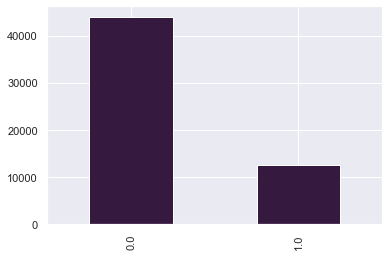

In [33]:
print(df['RainTomorrow'].value_counts())
df['RainTomorrow'].value_counts().plot(kind = 'bar')

#### This is a class imbalance. This is because there are many days in an year with no rain compared to the rainy days. For machine learning algorithms to learn properly there should be equal instances of both positive and negative labled classes

In [68]:
print(df.shape[0])
df = df.dropna()
print(df.shape[0])

145460
56420


In [35]:
X = df.drop(columns =['RainTomorrow'], axis =1)
y = df['RainTomorrow']

### label encoding

In [36]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder() 
X[cat] = X[cat].apply(le.fit_transform)

In [37]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=11)

### Over Sampling

Counter({0.0: 44004, 1.0: 12434})
Counter({0.0: 44004, 1.0: 44004})


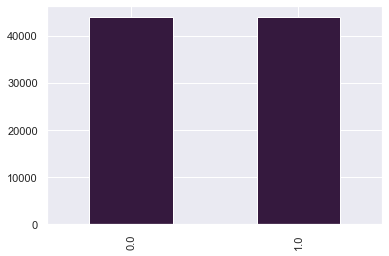

In [38]:
from collections import Counter
from imblearn.over_sampling import RandomOverSampler
print(Counter(y))

oversample = RandomOverSampler(sampling_strategy='minority')
X_train_over, y_train_over = oversample.fit_resample(X, y)

y_train_over.value_counts().plot(kind = 'bar')
print(Counter(y_train_over))

### Decission Tree

In [26]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score,KFold
from sklearn import metrics
from sklearn import tree
from sklearn.model_selection import GridSearchCV

In [27]:
clf = DecisionTreeClassifier(criterion="entropy", max_depth=3)
clf = clf.fit(X_train_over, y_train_over)
score = cross_val_score(clf, X_train_over, y_train_over, cv=10)

In [89]:
score.mean()

0.7342634966584376

In [90]:
y_pred_test = clf.predict(X_test)
y_pred_train = clf.predict(X_train_over)

In [91]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train))

cross val Accuracy= 0.7342634966584376
Test Accuracy: 0.7830144105835105
Train Accuracy: 0.7606922097991091


In [92]:
from sklearn import metrics
print(metrics.classification_report(y_test,y_pred_test))

              precision    recall  f1-score   support

         0.0       0.91      0.80      0.85     13179
         1.0       0.51      0.71      0.59      3753

    accuracy                           0.78     16932
   macro avg       0.71      0.76      0.72     16932
weighted avg       0.82      0.78      0.79     16932



In [48]:
feature_names = X.columns.tolist()
class_names = y.unique().tolist()
print(class_names)
class_names = ['NoRain', 'Rain']

[0.0, 1.0]


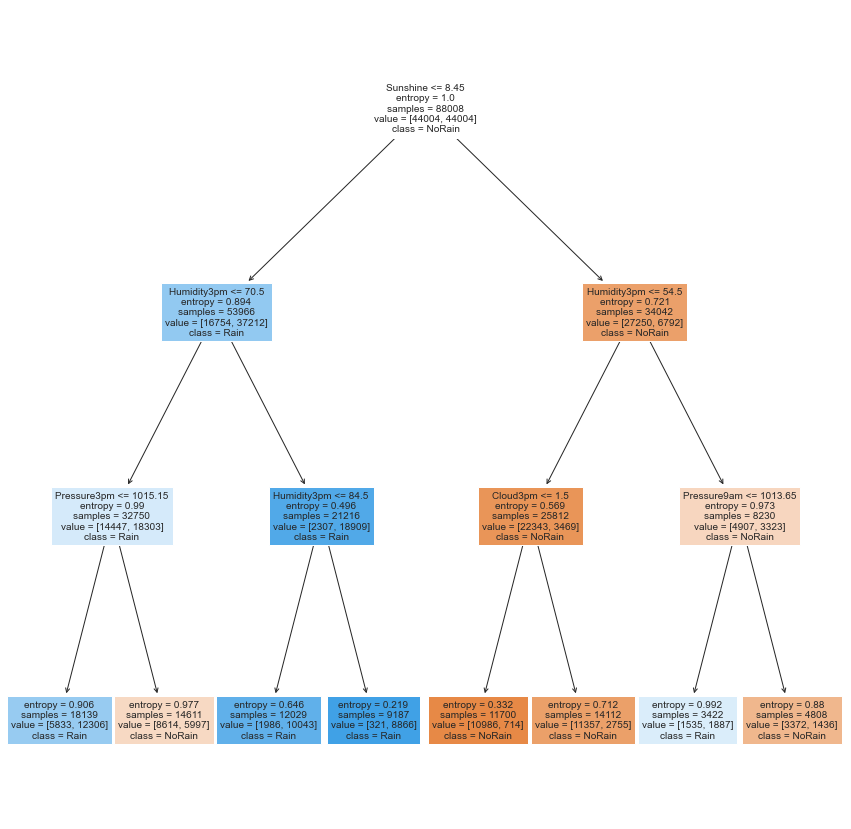

In [49]:
plt.figure(figsize=(15,15)) 
tree.plot_tree(clf,max_depth=3, fontsize=10,feature_names = feature_names, filled =True, class_names = class_names)
plt.savefig('decissionTree', dpi=100)
plt.show()

In [46]:
from scikitplot.metrics import plot_confusion_matrix as cm

<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

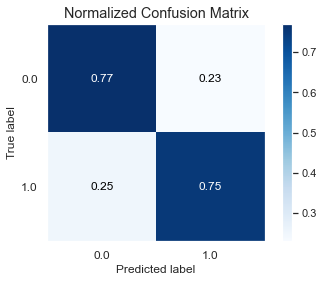

In [50]:
cm(y_test, y_pred_test, normalize=True)

### AUC value and ROC curve

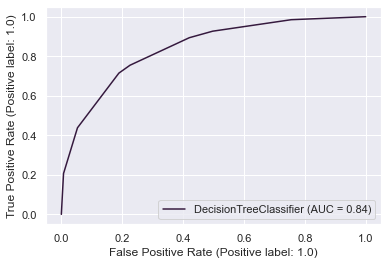

In [51]:
from sklearn.metrics import roc_curve            
metrics.plot_roc_curve(clf, X_test, y_test)  
plt.show()

### Random Forest

In [39]:
from sklearn.ensemble import RandomForestClassifier
clf_rf = RandomForestClassifier(max_depth=6, random_state=11)
clf_rf.fit(X_train_over, y_train_over)

RandomForestClassifier(max_depth=6, random_state=11)

In [40]:
score = cross_val_score(clf_rf, X_train_over, y_train_over, cv=10)

In [41]:
score

array([0.77593455, 0.77911601, 0.78911487, 0.74991478, 0.75855016,
       0.7102602 , 0.76923077, 0.83626861, 0.80693182, 0.78147727])

In [42]:
y_pred_test_rf = clf_rf.predict(X_test)
y_pred_train_rf = clf_rf.predict(X_train_over)

In [43]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test_rf))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train_rf))

cross val Accuracy= 0.7756799046595944
Test Accuracy: 0.7954169619655092
Train Accuracy: 0.8042791564403237


In [44]:
print(metrics.classification_report(y_test,y_pred_test_rf))

              precision    recall  f1-score   support

         0.0       0.94      0.79      0.86     13179
         1.0       0.52      0.82      0.64      3753

    accuracy                           0.80     16932
   macro avg       0.73      0.80      0.75     16932
weighted avg       0.85      0.80      0.81     16932



<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

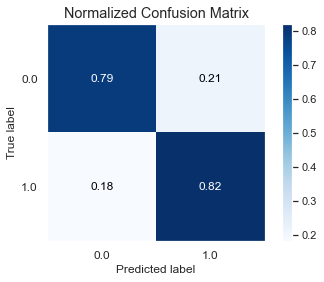

In [47]:
cm(y_test, y_pred_test_rf, normalize=True)

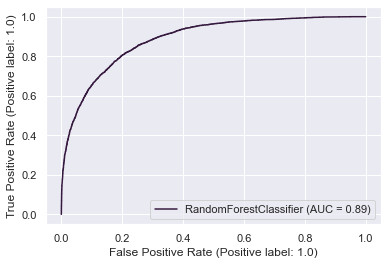

In [48]:
metrics.plot_roc_curve(clf_rf, X_test, y_test)  
plt.show()

### RandomForest Feature Importance through mean decrease impurity

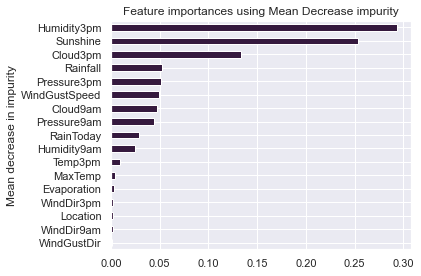

In [49]:
feature_names =  X.columns.tolist()
importances = clf_rf.feature_importances_
forest_importances = pd.Series(importances, index=feature_names).sort_values()
fig, ax = plt.subplots()
forest_importances.plot.barh()
ax.set_title("Feature importances using Mean Decrease impurity")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

### Naieve bayes

as most of the variables are gaussian in their univariate distributions shown we can go with Gaussian Naive bayes

In [60]:
 from sklearn.naive_bayes import GaussianNB

In [61]:
gnb = GaussianNB()
gnb.fit(X_train_over, y_train_over)

GaussianNB()

In [62]:
score = cross_val_score(gnb, X_train_over, y_train_over, cv=10)

In [63]:
score

array([0.76866265, 0.76832178, 0.74184752, 0.68855812, 0.70662425,
       0.77991137, 0.73877968, 0.81081695, 0.76977273, 0.80352273])

In [64]:
y_pred_test_gnb = gnb.predict(X_test)
y_pred_train_gnb = gnb.predict(X_train_over)

In [65]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test_gnb))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train_gnb))

cross val Accuracy= 0.7576817781553749
Test Accuracy: 0.7709662178124261
Train Accuracy: 0.7629760930824471


In [66]:
print(metrics.classification_report(y_test,y_pred_test_gnb))

              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     13179
         1.0       0.49      0.75      0.59      3753

    accuracy                           0.77     16932
   macro avg       0.70      0.76      0.72     16932
weighted avg       0.82      0.77      0.79     16932



<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

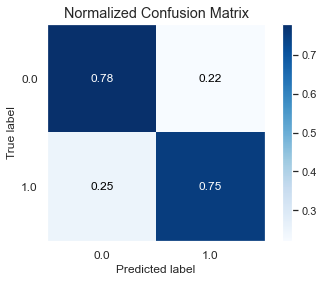

In [67]:
cm(y_test, y_pred_test_gnb, normalize=True)

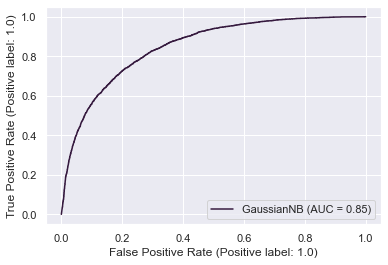

In [68]:
metrics.plot_roc_curve(gnb, X_test, y_test)  
plt.show()

### Logistic Regression

In [69]:
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [70]:
# clf_log = LogisticRegression(random_state=0).fit(X, y)
clf_log = make_pipeline(StandardScaler(), LogisticRegression(random_state=11)).fit(X, y)

In [71]:
clf_log.fit(X_train_over, y_train_over)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('logisticregression', LogisticRegression(random_state=11))])

In [72]:
score = cross_val_score(clf_log, X_train_over, y_train_over, cv=10)

In [73]:
y_pred_test_log = gnb.predict(X_test)
y_pred_train_log = gnb.predict(X_train_over)

In [74]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test_log))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train_log))

cross val Accuracy= 0.7837133086632717
Test Accuracy: 0.7709662178124261
Train Accuracy: 0.7629760930824471


In [75]:
print(metrics.classification_report(y_test,y_pred_test_log))

              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     13179
         1.0       0.49      0.75      0.59      3753

    accuracy                           0.77     16932
   macro avg       0.70      0.76      0.72     16932
weighted avg       0.82      0.77      0.79     16932



<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

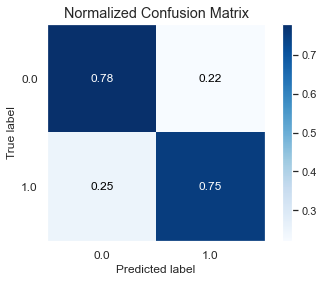

In [76]:
cm(y_test, y_pred_test_log, normalize=True)

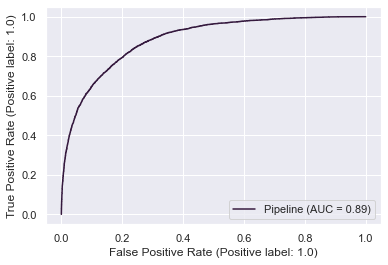

In [77]:
metrics.plot_roc_curve(clf_log, X_test, y_test)  
plt.show()

### SVM

In [78]:
from sklearn import svm

#### scaling numerical features through standard scalar

In [79]:
# clf_sv = make_pipeline(StandardScaler(), svm.SVC())
# clf_sv.fit(X_train_over, y_train_over)

In [80]:
clf_sv = make_pipeline(StandardScaler(), svm.SVC())
clf_sv.fit(X_train_over, y_train_over)

Pipeline(steps=[('standardscaler', StandardScaler()), ('svc', SVC())])

In [81]:
y_pred_test_sv = clf_sv.predict(X_test)
y_pred_train_sv = clf_sv.predict(X_train_over)

In [82]:
## Takes very long time to run
score = cross_val_score(clf_sv, X_train_over, y_train_over, cv=10)

In [83]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test_sv))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train_sv))

cross val Accuracy= 0.7548976046110463
Test Accuracy: 0.8192771084337349
Train Accuracy: 0.830185892191619


In [84]:
print(metrics.classification_report(y_test,y_pred_test_sv))

              precision    recall  f1-score   support

         0.0       0.95      0.81      0.88     13179
         1.0       0.56      0.84      0.67      3753

    accuracy                           0.82     16932
   macro avg       0.75      0.83      0.77     16932
weighted avg       0.86      0.82      0.83     16932



<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

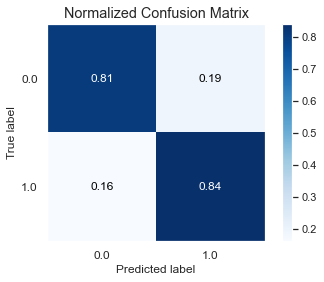

In [85]:
cm(y_test, y_pred_test_sv, normalize=True)

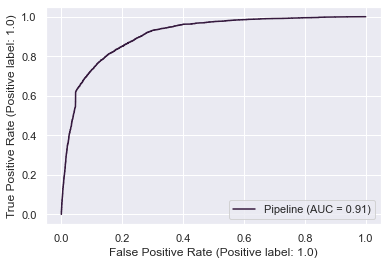

In [86]:
metrics.plot_roc_curve(clf_sv, X_test, y_test)  
plt.show()

### Deep-Neural network

In [87]:
from sklearn.neural_network import MLPClassifier

In [88]:
clf_mlp = make_pipeline(StandardScaler(), MLPClassifier(random_state=1, max_iter=300).fit(X_train_over, y_train_over))
clf_mlp.fit(X_train_over, y_train_over)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpclassifier', MLPClassifier(max_iter=300, random_state=1))])

In [89]:
y_pred_test_mlp = clf_mlp.predict(X_test)
y_pred_train_mlp = clf_mlp.predict(X_train_over)

In [90]:
print(metrics.classification_report(y_test,y_pred_test_mlp))

              precision    recall  f1-score   support

         0.0       0.95      0.84      0.89     13179
         1.0       0.60      0.83      0.70      3753

    accuracy                           0.84     16932
   macro avg       0.77      0.84      0.79     16932
weighted avg       0.87      0.84      0.85     16932



In [91]:
score = cross_val_score(clf_mlp, X_train_over, y_train_over, cv=10)

In [92]:
print('cross val Accuracy=',score.mean())
print("Test Accuracy:",metrics.accuracy_score(y_test, y_pred_test_mlp))
print("Train Accuracy:",metrics.accuracy_score(y_train_over, y_pred_train_mlp))

cross val Accuracy= 0.7484550683806591
Test Accuracy: 0.8397117883297898
Train Accuracy: 0.8412985183165167


<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

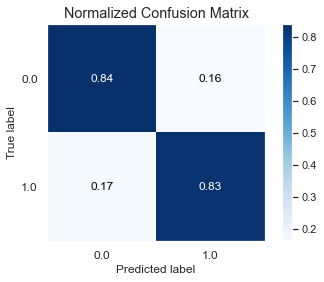

In [93]:
cm(y_test, y_pred_test_mlp, normalize=True)

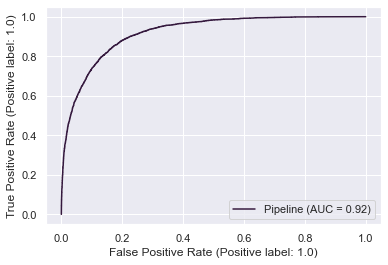

In [94]:
metrics.plot_roc_curve(clf_mlp, X_test, y_test)  
plt.show()